# Computer Vision: Assignment 2

Let's start off by importing all the libraries that we'll be needing

**Downgrade OpenCV a bit since some none-free features are not avilable, this is important for us to do the SIFT feature construction in the right way.** note that it requires a environment restart when executed

In [ ]:
!pip uninstall opencv-python -y
!pip install opencv-contrib-python==3.4.2.17 --force-reinstall

  Using cached https://files.pythonhosted.org/packages/61/29/fc60b2de1713aa92946992544329f20ccb5e4ba26290f403e04b7da44105/opencv_contrib_python-3.4.2.17-cp36-cp36m-manylinux1_x86_64.whl
  Using cached https://files.pythonhosted.org/packages/07/08/a549ba8b061005bb629b76adc000f3caaaf881028b963c2e18f811c6edc1/numpy-1.18.2-cp36-cp36m-manylinux1_x86_64.whl
ERROR: imgaug 0.2.9 requires opencv-python, which is not installed.
ERROR: dopamine-rl 1.0.5 requires opencv-python>=3.4.1.15, which is not installed.
ERROR: albumentations 0.1.12 requires opencv-python, which is not installed.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: numpy 1.18.2
    Uninstalling numpy-1.18.2:
      Successfully uninstalled numpy-1.18.2
  Found existing installation: opencv-contrib-python 3.4.2.17
    Unins

In [ ]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


## **Imported libraries**

In [ ]:
import os
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import pandas as pd
import seaborn as sn
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
# create large images
import matplotlib.pylab as pylab
from pylab import rcParams
rcParams['figure.figsize'] = 15,10

from urllib import request
import copy

import tensorflow as tf
!pip install keras_vggface
import keras
from keras_vggface.vggface import VGGFace
from keras_vggface import utils
from keras.preprocessing import image
from keras.engine import Model
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.cluster import MiniBatchKMeans
from sklearn.manifold import TSNE
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Using TensorFlow backend.


Import images

In [ ]:
base_path = "/content/sample_data/CV__Group_assignment"


**We initially used this code to download the VGG Face Dataset, but to make the execution more time efficient we decided to use the github repo**

In [ ]:
# legacy code to see how we got our images

# from google.colab import drive
# import tarfile
# import sys

# drive.mount('/content/drive', force_remount=True)
# start = time.time()
# base_path = "/content/drive/My Drive/cv_group_data/"

# if not os.path.isdir(base_path):
#   os.makedirs(base_path)


# vgg_face_dataset_url = "http://www.robots.ox.ac.uk/~vgg/data/vgg_face/vgg_face_dataset.tar.gz"

# with request.urlopen(vgg_face_dataset_url) as r, open(os.path.join(base_path, "vgg_face_dataset.tar.gz"), 'wb') as f:
#   f.write(r.read())


# with tarfile.open(os.path.join(base_path, "vgg_face_dataset.tar.gz")) as f:
#   f.extractall(os.path.join(base_path))

# trained_haarcascade_url = "https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml"

# with request.urlopen(trained_haarcascade_url) as r, open(os.path.join(base_path, "haarcascade_frontalface_default.xml"), 'wb') as f:
#     f.write(r.read())


# def check_duplicates(originals, image):
#   for original in originals:


#     difference = cv2.subtract(original, image)
#     b, g, r = cv2.split(difference)
#     if cv2.countNonZero(b) == 0 and cv2.countNonZero(g) == 0 and\
#      cv2.countNonZero(r) == 0:
#       print("The images are completely Equal")
#       return True

#     else:
#       return False

# pA = 'Sarah_Hyland.txt'
# pB = 'Jimmy_Fallon.txt'
# pC = 'Mila_Kunis.txt'
# pD = 'Josh_Radnor.txt'
# all_subjects = [pA, pB, pC, pD]

# #nb_images_per_subject = 30
# nb_images_per_subject = [30, 30, 10, 10]

# images = []
# train_set = []
# test_set = []
# used_urls = []
# for subject, nb_images in zip(all_subjects, nb_images_per_subject):
#   print(nb_images)

#   images_ = []

#   # for nb in reversed(range(1, nb_images+1)):
#   nb = nb_images

#   while nb > 0:
#     print(len(train_set))
#     print(nb)
#     if nb - 10 <= 0:
#       image_set = 'test'
#     else:
#       image_set = 'train'

#     subject_path = subject[:-4] + str(nb) + '.jpg'

#     # make directories for test and train set
#     if not os.path.isdir(base_path + image_set + '/'):
#       os.makedirs(base_path + image_set + '/')

#     img = cv2.imread(base_path + image_set + '/' + subject_path)
#     print(base_path + image_set + '/' + subject_path)

#     if img is None:
#       print(img)
#       with open(os.path.join(base_path, "vgg_face_dataset", "files", subject), 'r') as f:
#         lines = f.readlines()
#       for line in lines:
#         url = line[line.find("http://"): line.find(".jpg") + 4]
#         if url in used_urls:
#           print('image already used')
#           pass
#         else:
#           used_urls.append(url)
#           try:
#             res = request.urlopen(url)
#             img = np.asarray(bytearray(res.read()), dtype="uint8")
#             img = cv2.imdecode(img, cv2.IMREAD_COLOR)
#             # resizing once and for all
#             img = cv2.resize(img, (224, 224))
#             if check_duplicates(train_set, img) or\
#              check_duplicates(test_set, img):
#               pass
#             else:
#               h, w = img.shape[:2]
#               # cv2_imshow(cv2.resize(img, (w // 5, h // 5)))
#               print(base_path + image_set + '/' + subject_path)
#               cv2.imwrite(base_path + image_set + '/' + subject_path, img)
#               break

#           except:
#             e = sys.exc_info()
#             print("Error: {}".format(e))
#             pass
            
#     if check_duplicates(images_, img):
#       pass
#     else:
#       images_.append(img)

#     h, w = img.shape[:2]
#     # cv2_imshow(cv2.resize(img, (w // 5, h // 5)))  

#     if image_set == 'test':

#       if check_duplicates(test_set, img):
#         pass
#       else:
#         test_set.append(img)
#         nb -= 1

#     elif image_set == 'train':
#       if check_duplicates(train_set, img):
#         pass
#       else:
#         train_set.append(img)
#         nb -= 1
#   images.append(images_)
# end = time.time()

## **3.**

This github repo can be used instead of the dataset to be more time-efficient

In [ ]:
def download_image(url):
    res = request.urlopen(url)

    #if res.status_code != request.codes.ok:
    #    assert False, 'Status code error: {}.'.format(r.status_code)

    res = request.urlopen(url)
    img = np.asarray(bytearray(res.read()), dtype="uint8")
    img = cv2.imdecode(img, cv2.IMREAD_COLOR)
    img = cv2.resize(img, (224, 224))

    # print('Image downloaded from url: {}.'.format(url))
    return img

In [ ]:
train_set = []
train_set_a = []
train_set_b = []

train_targets = []
train_targets_a = []
train_targets_b = []

for i in range(11, 31):
    train_set_a.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/train/A/Sarah_Hyland' + str(i) + '.jpg'))
    train_targets_a.append(0)
    train_set_b.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/train/B/Jimmy_Fallon' + str(i) + '.jpg'))
    train_targets_b.append(1)

train_set = train_set_a + train_set_b
train_targets = train_targets_a + train_targets_b

test_set = []
test_set_a = []
test_set_b = []
test_set_c = []
test_set_d = []

test_targets = []
test_targets_a = []
test_targets_b = []
test_targets_c = []
test_targets_d = []

for i in range(1, 11):
    test_set_a.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/test/A/Sarah_Hyland' + str(i) +'.jpg'))
    test_targets_a.append(0)
    test_set_b.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/test/B/Jimmy_Fallon' + str(i) +'.jpg'))
    test_targets_b.append(1)
    test_set_c.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/test/C/Mila_Kunis' + str(i) +'.jpg'))
    test_targets_c.append(2)
    test_set_d.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/test/D/Josh_Radnor' + str(i) +'.jpg'))
    test_targets_d.append(3)

test_set = test_set_a + test_set_b + test_set_c + test_set_d
test_targets = test_targets_a + test_targets_b + test_targets_c + test_targets_d

images = train_set + test_set
labels = train_targets + test_targets

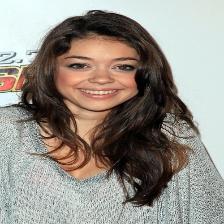

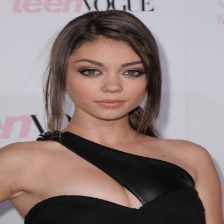

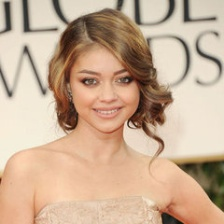

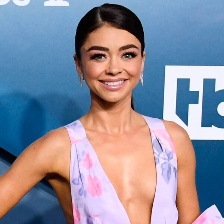

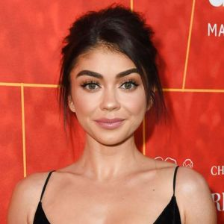

...

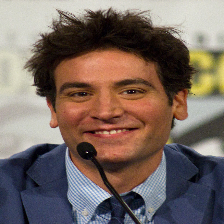

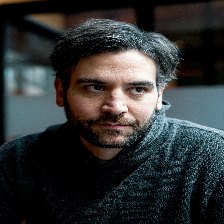

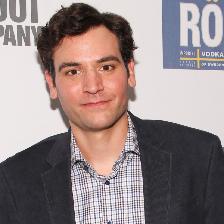

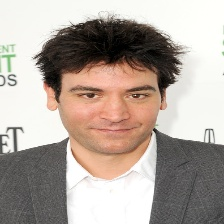

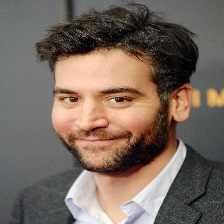

In [ ]:
for i in images:
  cv2_imshow(i)


### **Detect and extract faces**

In [ ]:
def get_faces(images=None, labels=False):

  if not os.path.isdir(base_path):
     os.makedirs(base_path)
  trained_haarcascade_url = "https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml"

  with request.urlopen(trained_haarcascade_url) as r, open(os.path.join(base_path, "haarcascade_frontalface_default.xml"), 'wb') as f:
    f.write(r.read())
  faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))
  
  # only storing labels we can use later for classification and identification
  # if a face isn't detected, it also shouldn't be part of the labels
  
  faceimg = []
  if labels is not False:
    face_labels = []
    for img, label in zip(images, labels):

      img_ = img.copy()
      img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
      # set a low number of neighbors each candidate rectangle should have to
      # have a higher probability to get at least one face
      faces = faceCascade.detectMultiScale(
            img_gray,
            scaleFactor=1.2,
            minNeighbors=2,
            minSize=(30, 30),
            flags=cv2.CASCADE_SCALE_IMAGE
        )
        
      print("Found {} face(s)! Only using one".format(len(faces)))
      if len(faces) != 0:
          faces = [faces[0]]
          for (x, y, w, h) in faces:
              # Extract face
              face = img_[y:y+h,x:x+w].copy()
              cv2.rectangle(img_, (x, y), (x+w, y+h), (0, 255, 0), 10)
          h, w = img_.shape[:2]
          faceimg.append(face)
          face_labels.append(label)

    return faceimg, face_labels
  else:
    for img in images:

      img_ = img.copy()
      img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
      # set a low number of neighbors each candidate rectangle should have to
      # have a higher probability to get at least one face
      faces = faceCascade.detectMultiScale(
            img_gray,
            scaleFactor=1.2,
            minNeighbors=2,
            minSize=(30, 30),
            flags=cv2.CASCADE_SCALE_IMAGE
        )
        
      print("Found {} face(s)! Only using one".format(len(faces)))
      if len(faces) != 0:
          faces = [faces[0]]
          for (x, y, w, h) in faces:
              # Extract face
              face = img_[y:y+h,x:x+w].copy()
              cv2.rectangle(img_, (x, y), (x+w, y+h), (0, 255, 0), 10)
          h, w = img_.shape[:2]
          faceimg.append(face)
    return faceimg

### **Get and show extracted faces**

Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

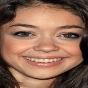

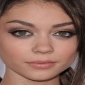

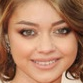

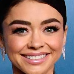

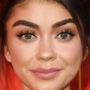

...

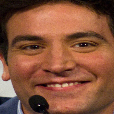

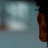

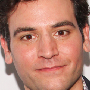

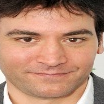

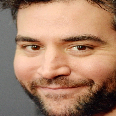

In [ ]:
faces, labels = get_faces(images, labels)
for face in faces:
  cv2_imshow(face)

## **4.1**

### **SIFT Feature detection**

The detectAndDescribe function determines the features for a given input image and returns the feature itself and its location (the keypoint). This information is stored in a list for later usage and visualised using the drawFeatures function.

Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

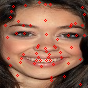

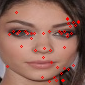

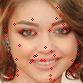

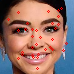

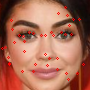

...

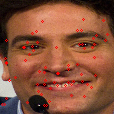

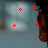

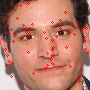

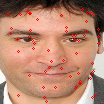

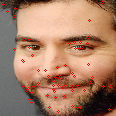

In [ ]:
# Detect and return features
def detectAndDescribe(image):		
		# detect and extract features from the image
		gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
		descriptor = cv2.xfeatures2d.SIFT_create()
		(kps, features) = descriptor.detectAndCompute(gray, None)
		# convert the keypoints from KeyPoint objects to NumPy
		# arrays
		kps = np.float32([kp.pt for kp in kps])
		# return a tuple of keypoints and features
		return (kps, features)

# Visualise the features   
def drawFeatures(img, kps):
    vis = copy.deepcopy(img)
    for (x,y) in kps:
        cv2.circle(vis,(x,y),1,(0,0,255),1)
    return vis

# Find the features in all images and append them to the lists
faces = get_faces(images)
featureList = []
keypointList = []
for face in faces:
	(keypoints,features) = detectAndDescribe(face)
	keypointList.append(keypoints)
	featureList.append(features)
	F = drawFeatures(face,keypoints)
	if F is None:
		print('ok')
	cv2_imshow(F)

Similar to the individual assignment 1 we convert the image to grayscale first to make the detection more robust. The detected features are concentrated around the eyes, nose, and mouth which are the expected locations to find recognisable features. Especially when people are smilling and showing their theeth features are concentrated around those areas.

### **Matching**

The lists containing the features and its location created in the previous section are now matched. A distance is computed and KNN (2-neighbours) is used for matching. This result is then visualised in the drawMatches function combining the 2 images and drawing a line between the matched features.

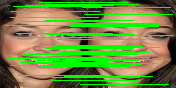

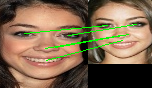

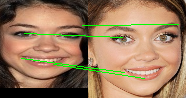

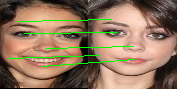

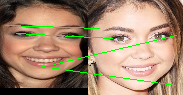

...

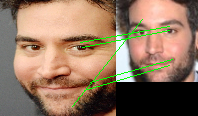

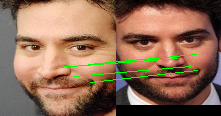

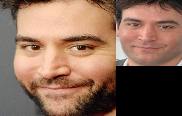

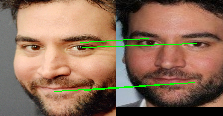

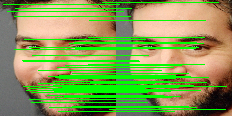

In [ ]:
def matchKeypoints(kpsA, kpsB, featuresA, featuresB,
		ratio, reprojThresh):
  
		# compute the raw matches and initialize the list of actual
		# matches
    matcher = cv2.DescriptorMatcher_create("BruteForce")
    rawMatches = matcher.knnMatch(featuresA, featuresB, 2)
    matches = []

		# loop over the raw matches
    for m in rawMatches:
      # ensure the distance is within a certain ratio of each
      # other (i.e. Lowe's ratio test)
      if len(m) == 2 and m[0].distance < m[1].distance * ratio:
        matches.append((m[0].trainIdx, m[0].queryIdx))

    # computing a homography requires at least 4 matches
    if len(matches) > 4:
      # construct the two sets of points
      ptsA = np.float32([kpsA[i] for (_, i) in matches])
      ptsB = np.float32([kpsB[i] for (i, _) in matches])

      # compute the homography between the two sets of points
      (H, status) = cv2.findHomography(ptsA, ptsB, cv2.RANSAC,
        reprojThresh)

      # return the matches along with the homograpy matrix
      # and status of each matched point
      return (matches, H, status)

    # otherwise, no homograpy could be computed
    return None

def drawMatches(imageA, imageB, kpsA, kpsB, matches, status):
    # initialize the output visualization image
    (hA, wA) = imageA.shape[:2]
    (hB, wB) = imageB.shape[:2]
    vis = np.zeros((max(hA, hB), wA + wB, 3), dtype="uint8")
    vis[0:hA, 0:wA] = imageA
    vis[0:hB, wA:] = imageB

    # loop over the matches
    for ((trainIdx, queryIdx), s) in zip(matches, status):
      # only process the match if the keypoint was successfully
      # matched
      if s == 1:
        # draw the match
        ptA = (int(kpsA[queryIdx][0]), int(kpsA[queryIdx][1]))
        ptB = (int(kpsB[trainIdx][0]) + wA, int(kpsB[trainIdx][1]))
        cv2.line(vis, ptA, ptB, (0, 255, 0), 1)

    # return the visualization
    return vis

ratio = 0.75
reprojThresh = 4.0

# Loop twice over all images, match, and visualise
for indexA in range(len(faces)):
    keypointsA = keypointList[indexA]
    featuresA = featureList[indexA]
    for indexB in range(len(faces)):
      keypointsB = keypointList[indexB]
      featuresB = featureList[indexB]
      M = matchKeypoints(keypointsA, keypointsB, featuresA, featuresB, ratio, reprojThresh)
      # If not matches found continue
      if M is None:
        continue
      (matches, H, status) = M
      vis = drawMatches(faces[indexA], faces[indexB], keypointsA, keypointsB, matches,status)
      cv2_imshow(vis)

## **4.2**

### **4.2.1: Unsupervised learning: PCA**

First we extract all the faces from the training images. The faces are scaled and converted to grayscale. We use the SVD approach embedded in the PCA function in the sklearn library. SVD is the more convenient approach as it doesn’t require computing the covariance matrix separately. It does however require that the faces are centered. Since the recognized faces are already centered this is the best appropriate approach to use.
The aim of PCA is to reduce the dimensionality of the data without losing too much of the quality of the image. With 20 p-components we can retain 90% of the quality and thus informative images during the reconstructions. As we can see in the convex graph, the value of every new component is less than the previous one. Hence adding extra components results in very limited gains.



In [ ]:
train_faces = get_faces(train_set)
test_faces = get_faces(test_set)

Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

(40, 4096)


<Figure size 360x360 with 0 Axes>

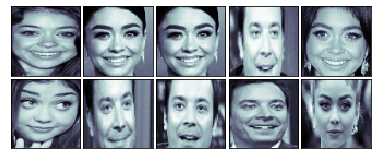

(40, 20)


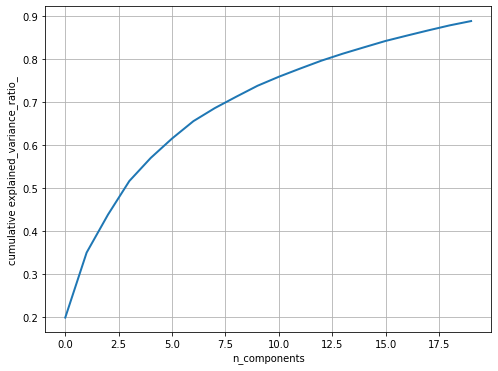

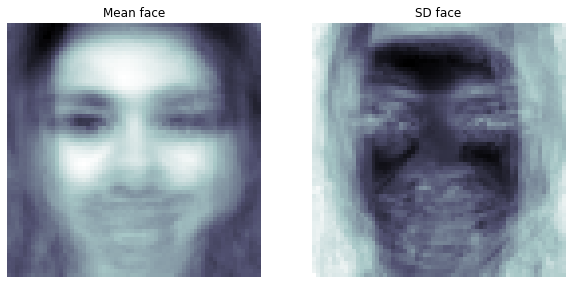

In [ ]:
faces = train_faces

fig = plt.figure(figsize=(5,5)) 
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05) 

# plot the faces 
j = 1

faces = [cv2.resize(face, (64,64)) for face in faces]
faces = [cv2.cvtColor(face, cv2.COLOR_BGR2GRAY) for face in faces]
faces = np.asarray(faces)
nsamples, nx, ny = faces.shape
faces = faces.reshape((nsamples,nx*ny))
print(faces.shape)

fig = plt.figure(figsize=(5,5)) 
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05) 
# plot 10 random faces
j = 1
np.random.seed(0)
for i in np.random.choice(range(faces.shape[0]), 10): 
    ax = fig.add_subplot(5, 5, j, xticks=[], yticks=[]) 
    ax.imshow(np.reshape(faces[i,:],(64,64)), cmap=plt.cm.bone, interpolation='nearest') 
    j += 1
plt.show()

n_comp = 20

pipeline = Pipeline([('scaling', StandardScaler()), ('pca', PCA(n_components=n_comp))])
faces_proj = pipeline.fit_transform(np.asarray(faces))
print(faces_proj.shape)

mean_face = np.reshape(pipeline.named_steps['scaling'].mean_, (64,64))
sd_face = np.reshape(np.sqrt(pipeline.named_steps['scaling'].var_), (64,64))
pylab.figure(figsize=(8, 6))
pylab.plot(np.cumsum(pipeline.named_steps['pca'].explained_variance_ratio_), linewidth=2)
pylab.grid(), pylab.axis('tight'), pylab.xlabel('n_components'), pylab.ylabel('cumulative explained_variance_ratio_')
pylab.show()
pylab.figure(figsize=(10,5))
pylab.subplot(121), pylab.imshow(mean_face, cmap=pylab.cm.bone), pylab.axis('off'), pylab.title('Mean face')
pylab.subplot(122), pylab.imshow(sd_face, cmap=pylab.cm.bone), pylab.axis('off'), pylab.title('SD face')
pylab.show()


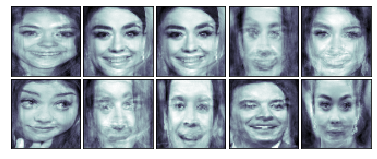

In [ ]:
# face reconstruction
faces_inv_proj = pipeline.named_steps['pca'].inverse_transform(faces_proj) 
#reshaping as 20 images of 64x64 dimension 
fig = plt.figure(figsize=(5,5)) 
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05) 
# plot the faces, each image is 64 by 64 dimension but 8x8 pixels 
j = 1
np.random.seed(0)
for i in np.random.choice(range(faces.shape[0]), 10): 
    ax = fig.add_subplot(5, 5, j, xticks=[], yticks=[]) 
    ax.imshow(mean_face + sd_face*np.reshape(faces_inv_proj,(40,64,64)) [i,:], cmap=plt.cm.bone, interpolation='nearest')
    j += 1

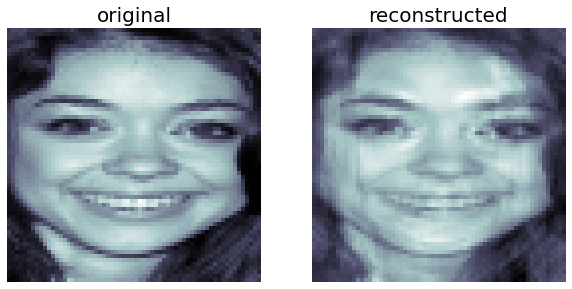

In [ ]:
#print(faces_proj[0,:].shape)
#print(pipeline.named_steps['pca'].components_.shape)
orig_face = np.reshape(faces[0,:], (64,64))
reconst_face = np.reshape(faces_proj[0,:]@pipeline.named_steps['pca'].components_, (64,64))
reconst_face = mean_face + sd_face*reconst_face
plt.figure(figsize=(10,5))
plt.subplot(121), plt.imshow(orig_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('original', size=20)
plt.subplot(122), plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('reconstructed', size=20)
plt.show()

We now project the learned components on the test set and plot these on a face-feature plot of the first two components. On the plot we see that similar faces are somewhat clustered. It is however hard to draw conclusions from this as the first two components combined only cover around 40% of the variance.

In [ ]:
#for each face of test set, project p-components
reconstructed_test = []
j=0
for face in faces_proj:
    reconst_face = np.reshape(faces_proj[j,:]@pipeline.named_steps['pca'].components_, (64,64))
    reconst_face = mean_face + sd_face*reconst_face
    j+=1
    reconstructed_test.append(reconst_face)

reconstructed_array_test = np.asarray(reconstructed_test)
nsamples, nx, ny = reconstructed_array_test.shape
reconstructed_array_test = reconstructed_array_test.reshape((nsamples,nx*ny))
test_proj = pipeline.transform(np.asarray(reconstructed_array_test))

In [ ]:
# scaled_test = [cv2.resize(face, (64,64)) for face in test_faces]
# scaled_test = [cv2.cvtColor(face, cv2.COLOR_RGB2GRAY) for face in scaled_test]
# scaled_test = np.asarray(scaled_test)
# nsamples, nx, ny = scaled_test.shape
# scaled_test = scaled_test.reshape((nsamples,nx*ny))
# test_proj = pipeline.transform(np.asarray(scaled_test))

In [ ]:
x = test_proj[:,0]
y = test_proj[:,1]

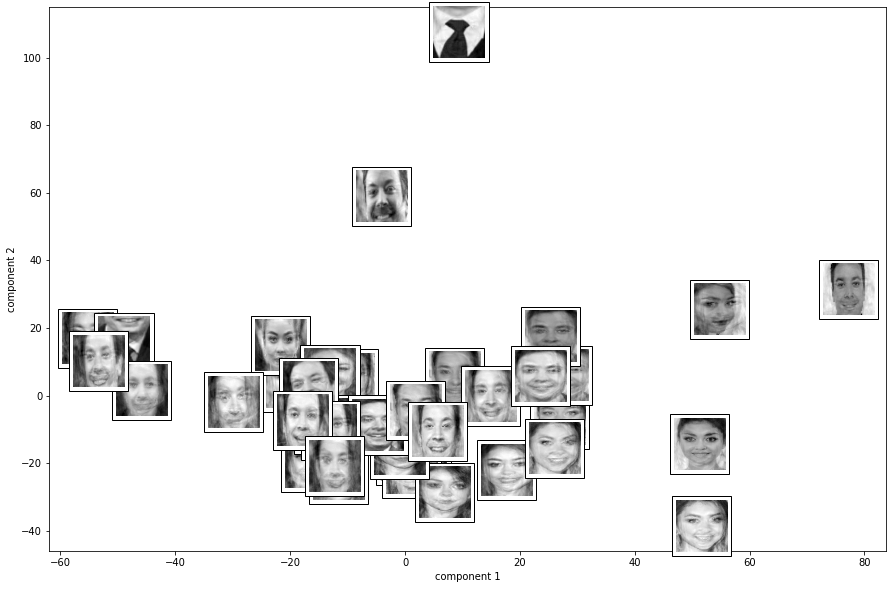

In [ ]:
#plot new faces

#Images to plot: projection of test faces on first and second eigenface

from matplotlib.offsetbox import AnnotationBbox, OffsetImage

fig = plt.gcf()
fig.clf()
ax = plt.subplot(111)
ax.scatter(x, y)
for x0, y0, img in zip(x, y,reconstructed_test):

  # add a first image
  imagebox = OffsetImage(img, zoom=.8, cmap=plt.cm.gray)
  xy = [x0, y0]               # coordinates to position this image

  ab = AnnotationBbox(imagebox, xy,
    xybox=(0., 0.),
    xycoords='data',
    boxcoords="offset points")                                  
  ax.add_artist(ab)
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.show()

In [ ]:
# short piece of code to get pca features
def get_pca_features(images, n_components=30):
  if len(images) < 30:
    n_components = len(images)
  images = [cv2.resize(face, (64,64)) for face in images]
  images = [cv2.cvtColor(face, cv2.COLOR_BGR2GRAY) for face in images]
  images = np.asarray(images)
  nsamples, nx, ny = images.shape
  images = images.reshape((nsamples,nx*ny))
  pipeline = Pipeline([('scaling', StandardScaler()), ('pca', PCA(n_components=n_components))])
  faces_proj = pipeline.fit_transform(np.asarray(images))

  return faces_proj

### **4.2.2: Pre-trained VGG-Face detection visualized with T-SNE**

First, import pre-trained VGG-Face network and T-SNE algorithm

In this section, we'll use the deep convolutional neural network, developed by Oxford's Visual Geometry Group: the VGG Network. This networked performed good on the renowned ImageNet Dataset. More speficically, we'll use a pre-trained
VGG16 (15 conv layers) network that achieves a 92.7% top-5 test accuracy in ImageNet.  

We'll start off by taking a pre-trained VGG16 network that was trained on data displaying people's faces. Next, we'll use the trained model on our faces and predict use the output of the network to cut off the laster layer and take these network outputs. The first two elements of this feature space will be used to visualize the faces.

This way, we can see if the has learned to put similar faces closer together in its output feature space.


In [ ]:
# check if you do really got tensorflow 1.15. The VGG model we're using, only works with a tensorflow version below 2.
print(tf.__version__)

1.15.2


In [ ]:
feature_extraction = None

In [ ]:
# custom paramers
image_path = get_faces(images) # images variable or addres of images
no_of_images = len(image_path) # number of images. It is recommended to use a square of 2 number
ellipside = True # elipsoid or rectangular visualization
image_width = faces[0].shape[0] # width and height of the first image, only for visualization
# choices are: inception, raw and vggfaces
feature_extraction = 'inception' # feature extraction method


Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

In [ ]:
# VGG feature detection
def get_vgg_features(faces, no_of_images):
  # clear sessions, should do the same thing but just to be sure
  tf.keras.backend.clear_session()
  keras.backend.clear_session()
  # Convolution Features
  vgg_model_conv1 = VGGFace(include_top=False, input_shape=(172, 172, 3), 
                              pooling='avg') # pooling: None, avg or max
  # FC7 Features
  vgg_model = VGGFace() # pooling: None, avg or max
  out = vgg_model.get_layer('fc7').output
  vgg_model_fc7 = Model(vgg_model.input, out)

  features = np.zeros([no_of_images, 4096])
  for i, img in enumerate(faces):
    img = cv2.resize(img, (224, 224))
    # img = image.load_img(name, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = utils.preprocess_input(x)
    features[i, :] = vgg_model_fc7.predict(x)

  return features

In [ ]:
features = get_vgg_features(image_path, no_of_images)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.




We'll be using the T-SNE algorithm. This dimensionally reduction algorithm that was developed by Laurens van der Maaten en Geoffry Hinton is great for visualizing high dimension data in a 2D space.

In [ ]:
tsne = TSNE()
reduced = tsne.fit_transform(features)
reduced_transformed = reduced - np.min(reduced, axis=0)
reduced_transformed /= np.max(reduced_transformed, axis=0)
image_xindex_sorted = np.argsort(np.sum(reduced_transformed, axis=1))

In [ ]:
tsne

TSNE(angle=0.5, early_exaggeration=12.0, init='random', learning_rate=200.0,
     method='barnes_hut', metric='euclidean', min_grad_norm=1e-07,
     n_components=2, n_iter=1000, n_iter_without_progress=300, n_jobs=None,
     perplexity=30.0, random_state=None, verbose=0)

In [ ]:
x = reduced[:,0]
y = reduced[:,1]

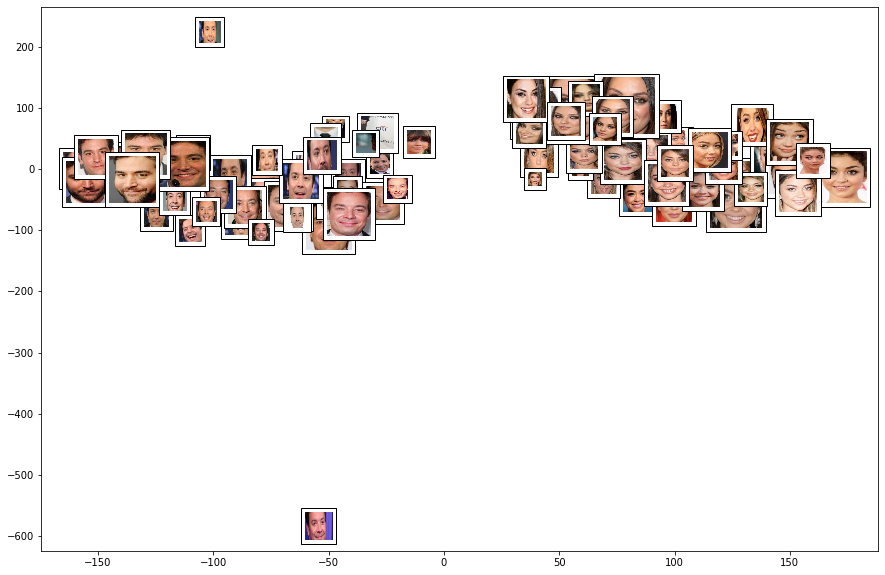

In [ ]:
from matplotlib.offsetbox import AnnotationBbox, OffsetImage

fig = plt.gcf()
fig.clf()
ax = plt.subplot(111)
ax.scatter(x, y)
for x0, y0, img in zip(x, y,image_path):

  # add a first image
  rgb_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  imagebox = OffsetImage(rgb_img, zoom=.4)
  xy = [x0, y0]               # coordinates to position this image

  ab = AnnotationBbox(imagebox, xy,
    xybox=(0., 0.),
    xycoords='data',
    boxcoords="offset points")                                  
  ax.add_artist(ab)
plt.show()

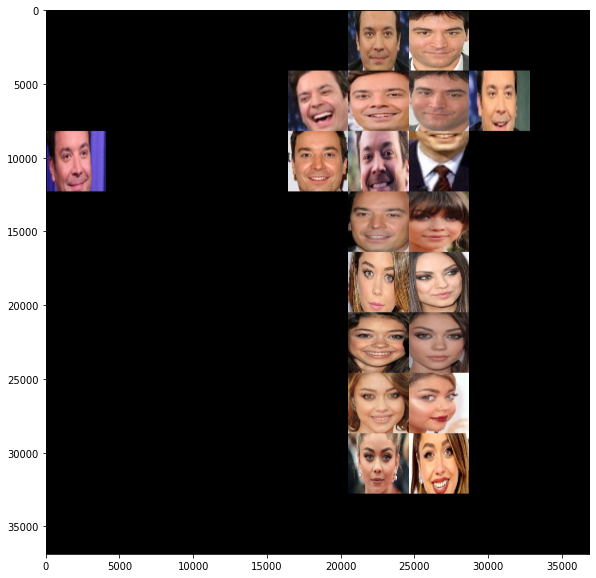

In [ ]:
# draw all images in a merged image
merged_width = int(np.ceil(np.sqrt(no_of_images))*image_width)
merged_image = np.zeros((merged_width, merged_width, 3), dtype='uint8')

for counter, index in enumerate(image_xindex_sorted):
    # set location
    if ellipside:
        a = np.ceil(reduced_transformed[counter, 0] * (merged_width-image_width-1)+1)
        b = np.ceil(reduced_transformed[counter, 1] * (merged_width-image_width-1)+1)
        a = int(a - np.mod(a-1,image_width) + 1)
        b = int(b - np.mod(b-1,image_width) + 1)
        if merged_image[a,b,0] != 0:
            continue
        rgb_img = cv2.cvtColor(image_path[counter], cv2.COLOR_BGR2RGB)
        img = cv2.resize(rgb_img, (image_width, image_width))

        merged_image[a:a+image_width, b:b+image_width,:] = img[:,:,:3]
    else:
        b = int(np.mod(counter, np.sqrt(no_of_images)))
        a = int(np.mod(counter//np.sqrt(no_of_images), np.sqrt(no_of_images)))
        rgb_img = cv2.cvtColor(image_path[counter], cv2.COLOR_BGR2RGB)
        img = cv2.resize(rgb_img, (image_width, image_width))
        merged_image[a*image_width:(a+1)*image_width, b*image_width:(b+1)*image_width,:] = img[:,:,:3]

plt.imshow(merged_image)
plt.show()
merged_image = Image.fromarray(merged_image)
# if ellipside:
#     merged_image.save('merged-%s-ellipsoide-inception.png'%image_path.split('/')[-2])
# else:
#     merged_image.save('merged-%s.png'%image_path.split('/')[-2])


Although the visualization method is a little bit different, both visualizations clearly show the outcome of the T-SNE algorithm on the VGG features. Faces that belong to the same person are clustered closely together in the 2D space. Moreover, the faces of similar looking persons are also clustered closely together and wrongly labeled faces are all the way on the outer end of the 2D space.

## **5.1**


### **Person classification**

The next part will focus on using the pre-defined features to build a classifier and classify the different faces, belonging to the respective persons as good as possible.

#### Feature Pipeline

In [ ]:
# sift feature helpers
# first create a so-called bag of visual words for implementing sift keypoints
# that we detected in the train data. The K-Means model will be used in the
# feature creation

def clusterize_features(features, num_clusters):
    sift_features = np.concatenate(features, axis=0)

    kmeans = MiniBatchKMeans(n_clusters=num_clusters, 
                             random_state=0).fit(sift_features)
    #return the learned model
    return kmeans
sift_features = []
for img in train_faces:
  (keypoints,features) = detectAndDescribe(img)
  sift_features.append(features)

sift_features = np.asarray(sift_features)

kmeans_model = clusterize_features(sift_features, 5)

In [ ]:
# define the feature pipeline

def create_features(images: list = None, feature_representation: str = None,
                    n_components: int = 30):

  # resize images to the same size
  images = [cv2.resize(img, (224, 224)) for img in images]

  if feature_representation == 'sift':
    sift_features = []
    for img in images:
    
      (keypoints,features) = detectAndDescribe(img)
      
      predict_kmeans = kmeans_model.predict(features)
      hist, bin_edges = np.histogram(predict_kmeans)
      #histogram is the feature vector
      sift_features.append(hist)
    sift_features = np.asarray(sift_features)

    return sift_features

  elif feature_representation == 'vgg':
    vgg_features = get_vgg_features(images, len(images))
    return vgg_features

  elif feature_representation == 'pca':
    pca_features = get_pca_features(images, n_components)
    return pca_features

  else:
    print('No feature algorithm was selected')

Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

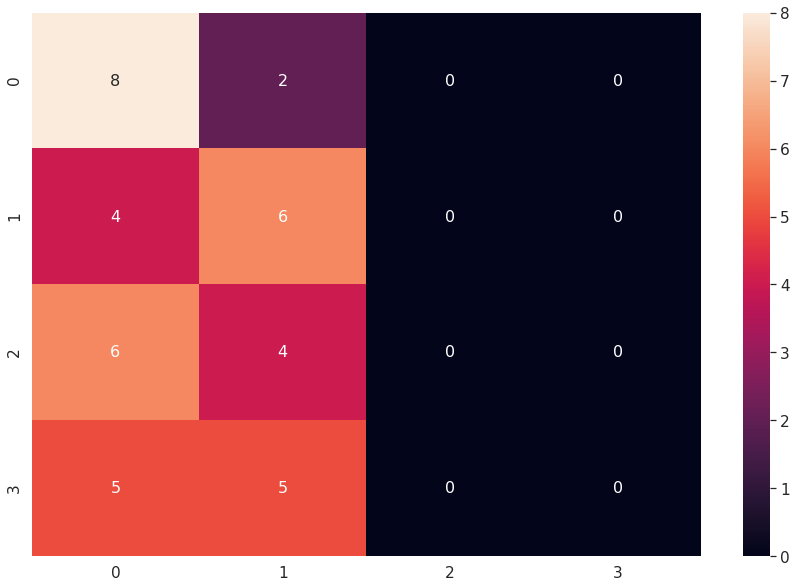

Train Accuracy for pca features with model LogisticRegression is 100.0%.
Test Accuracy for pca features with model LogisticRegression is 15.0%.


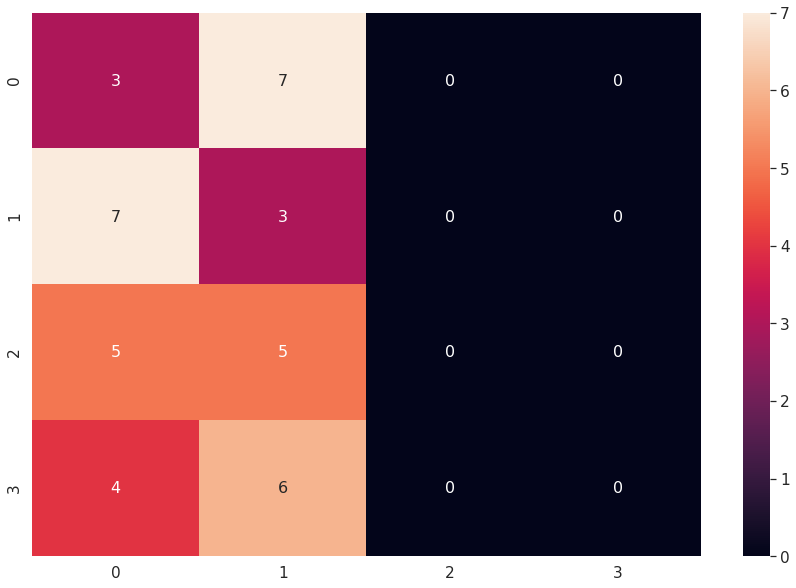

Train Accuracy for vgg features with model LogisticRegression is 100.0%.
Test Accuracy for vgg features with model LogisticRegression is 50.0%.


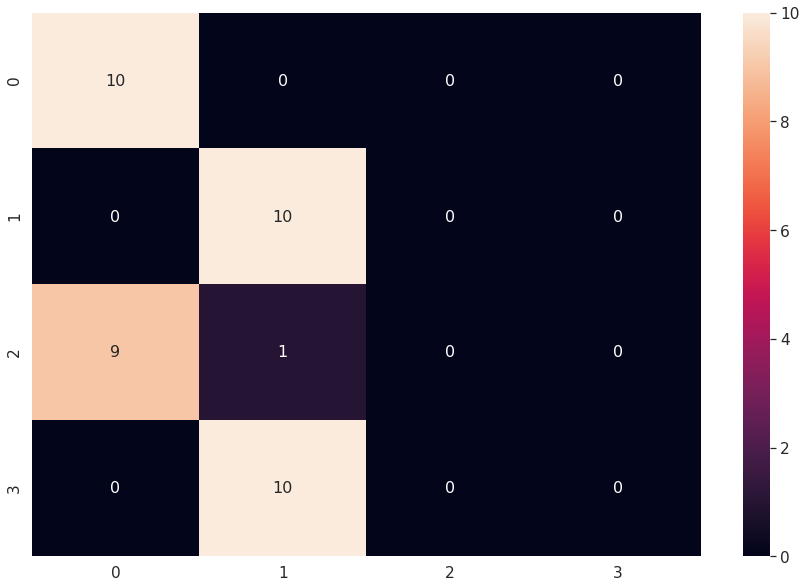

Train Accuracy for sift features with model GaussianNB is 70.0%.
Test Accuracy for sift features with model GaussianNB is 35.0%.


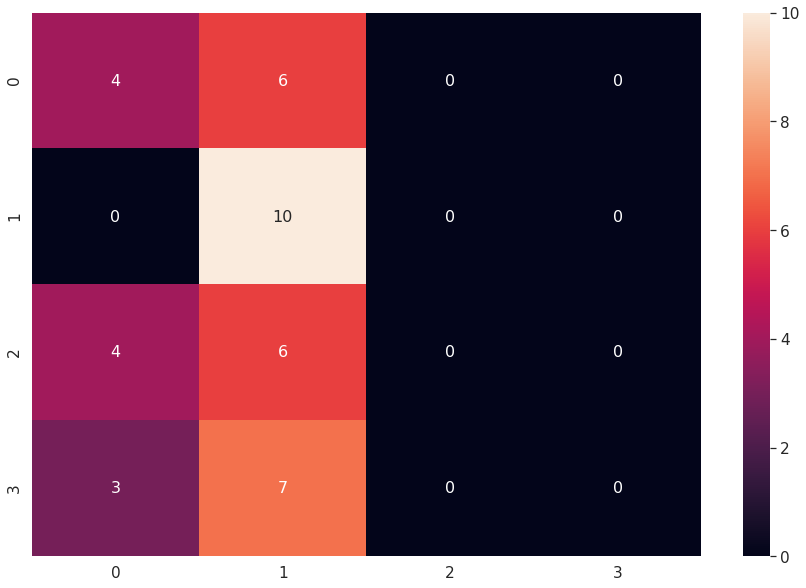

Train Accuracy for pca features with model GaussianNB is 97.5%.
Test Accuracy for pca features with model GaussianNB is 12.5%.


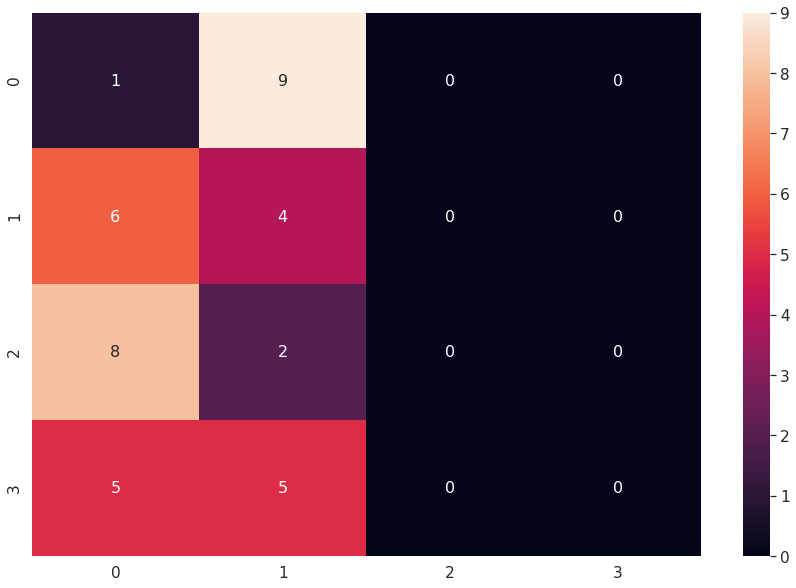

Train Accuracy for vgg features with model GaussianNB is 100.0%.
Test Accuracy for vgg features with model GaussianNB is 47.5%.


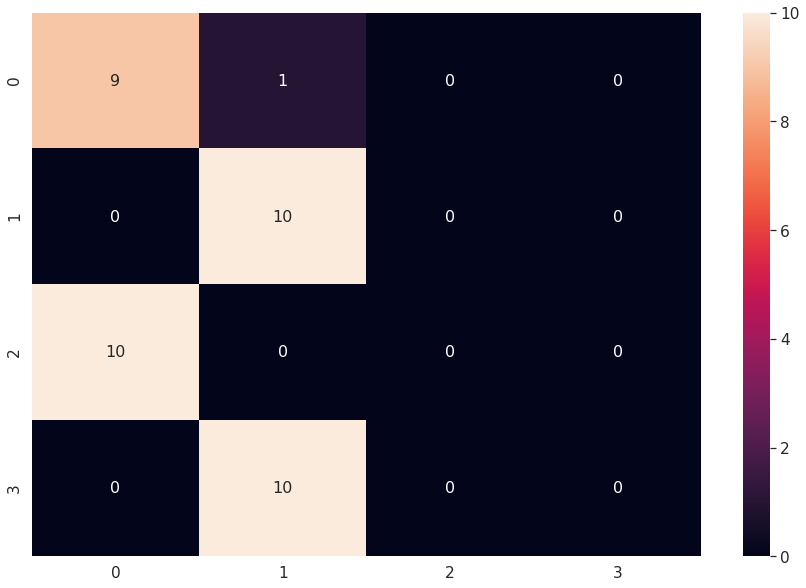

Train Accuracy for sift features with model RandomForestClassifier is 100.0%.
Test Accuracy for sift features with model RandomForestClassifier is 32.5%.


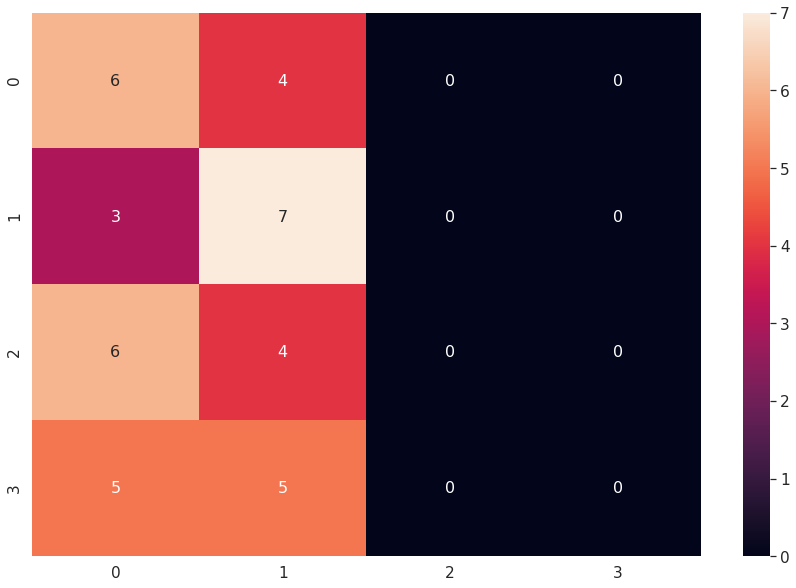

Train Accuracy for pca features with model RandomForestClassifier is 100.0%.
Test Accuracy for pca features with model RandomForestClassifier is 22.5%.


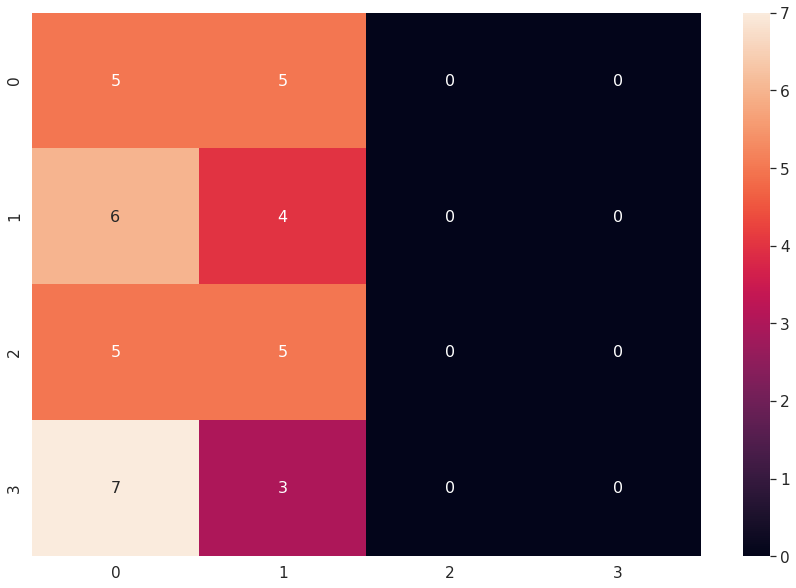

Train Accuracy for vgg features with model RandomForestClassifier is 100.0%.
Test Accuracy for vgg features with model RandomForestClassifier is 47.5%.


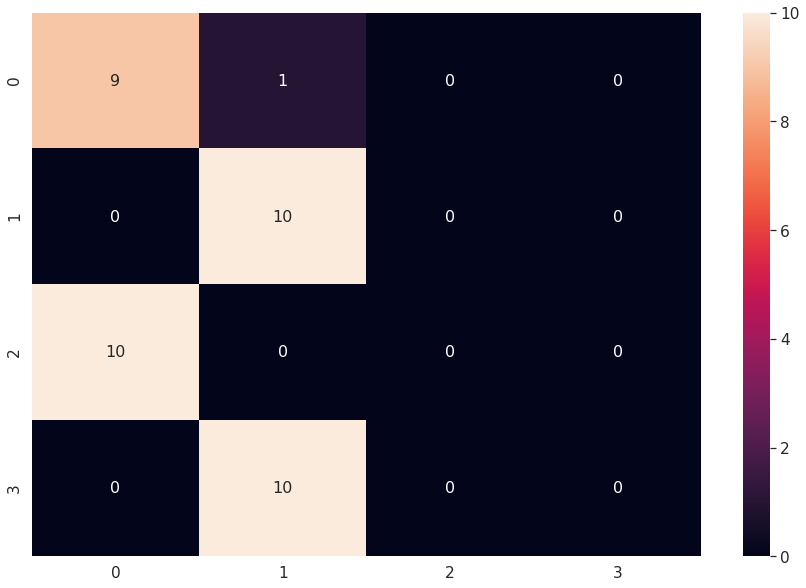

In [ ]:
train_faces = get_faces(train_set)
test_faces = get_faces(test_set)
models = [LogisticRegression(), GaussianNB(), RandomForestClassifier()]
feature_representations = ['sift', 'pca', 'vgg']
for model in models:
  for feature_representation in feature_representations:
    train_features = create_features(images=train_faces, 
                                  feature_representation=feature_representation)
    test_features = create_features(images=test_faces, 
                                  feature_representation=feature_representation)
    train_features = np.asarray(train_features)
    test_features = np.asarray(test_features)

    model.fit(np.asarray(train_features), np.asarray(train_targets))
    train_predictions = model.predict(train_features)
    test_predictions = model.predict(test_features)
    print("Train Accuracy for {} features with model {} is {}%.".format(feature_representation, 
                                                                        type(model).__name__,
                                                                        accuracy_score(train_targets, train_predictions)*100))
    print("Test Accuracy for {} features with model {} is {}%.".format(feature_representation,
                                                                    type(model).__name__,
                                                                    accuracy_score(test_targets, test_predictions)*100))
    
    conf = confusion_matrix(test_targets, test_predictions)
    df_cm = pd.DataFrame(conf, range(len(set(test_targets))), range(len(set(test_targets))))
    # plt.figure(figsize=(10,7))
    sn.set(font_scale=1.4) # for label size
    sn.heatmap(df_cm, annot=True, annot_kws={"size": 16}) # font size

    plt.show()


**Classification conclusion**

In this part we used 3 different feature representations for classifying the different faces of the persons in the test set. All these feature representations were trained on classification models that are derived from a so-called *different Machine Learning Family* to get a better view on how good the feature representations can be used to classify. Improvements could be made to these models since no parameter fine-tuning was done in this set-up.

It is important to note that the 'similar looking' faces of different persons in the test set got their own label. It was not clear whether this was the correct way to do this or that they should have gotten the label of the person they look similar too. In any case, it is impossible for a supervised learning model to classifiy an unseen label. However, we can still draw conclusions for their predicted class. The prediction on the train set was done to set a benchmarking example and to be sure that the training of the models was done correctly. They should all be at 100% accuracy because the model has already seen these examples.

In short, the VGG Features do a far better job in all models than the other two feature representations. It labels the first two (seen) persons from the test set perfectly. Moreover, it also near perfect labels the similar looking persons to the ones they look like. This shouldn't surprise us. On the one hand, the VGG features are drawn from a very recent, very deep convolutional model that has a well-thought architecture and a proven record of ranking high in image classification competitions. On the other hand, these are the only features that were created by training on a vast amount of images since we're using a pre-trained model. Still, the training set we're using for our classification, is still way to small to obtain the best results.

The other two feature representations were not created by cutting of a pre-trained model. Instead SIFT and PCA 'harvest' the key elements of the images to try and create meaningful representations of the images that can be used in a classification algorithm. The SIFT algorithm performs slightly better than a random assignment of labels would. At performs worse on labeling the 'similar' faces. This is not very good and could be a result of the lack of training data. Apart from that, the number of keypoints and the number of clusters could also be fine-tuned to improve this feature representation.

Finally, the PCA feature representation performs worse than a random baseline classifier would. A fine-tuning of the number of components to take, could improve this model.

To conclude, it seems that the VGG feature representation is the most robust representation to classify the image correctly. We can verify this because it is the best performing feature, regardless of the model used. The carefully designed model architecture and the huge dataset that was used for training it, can explain the strength of the VGG feature representation.

## **5.2**


### **Identification SIFT**

The classifcation works by first creating a feature space using the trainingset. This is done by creating a KNN classifier and using the fit function on the training set. This dataspace containing the labelled feature information can then be using for identification of a person. This identification is done by using KNN with 3-neighbors for every feature of a new face. This returns a classification value for every feature out of which the mode (most common) value is chosen as the result. Note that instead of taking the mode a simple percentage could be outputted indicating how sure you are. For the purpose of the assignment however we took the most likely person as the output in order to provide reliable identification. A short discussion on these results and the value of K is provided below.

In [ ]:
train_faces = get_faces(train_set)
test_faces = get_faces(test_set)
feature_representation = 'sift'
train_features = create_features(images=train_faces, 
                                feature_representation=feature_representation)
test_features = create_features(images=test_faces, 
                                feature_representation=feature_representation)
train_features = np.asarray(train_features)
test_features = np.asarray(test_features)
# Nr of neighbors used for KNN
n_neighbors = 5

# Create feature space using the train images
clf = KNeighborsClassifier(n_neighbors, weights='distance')
clf.fit(np.asarray(train_features), np.asarray(train_targets))
train_predictions = clf.predict(train_features)
test_predictions = clf.predict(test_features)
print("Train Accuracy for {} features is {}%.".format(feature_representation, 
                                                accuracy_score(train_targets, train_predictions)*100))
print("Test Accuracy for {} features is {}%.".format(feature_representation, 
                                                accuracy_score(test_targets, test_predictions)*100))

print(clf.predict_proba(test_features))


Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

A value of 3-neighbours for KNN was used which resulted in a 100% accuracy on the trainset and a 80% accuracy on the test set with the same person. This indicates that only 4 new images were classified wrong so these are decently accurate results. When we test using the test set containing similar persons (C/D) we see that the accuracy drops drastically, as expected, to 60%. This is the main reason why we chose a value of 3-neighbours for KNN since now the accuracy for a lookalike person is almost as good as a random guess. If a lower value of K is used this accuracy goes up which results in identifying similar persons as the same which was considered an undesired effect for an identification system. 

### **Identification VGG**

In [ ]:
train_faces = get_faces(train_set)
test_faces = get_faces(test_set)
feature_representation = 'vgg'
train_features = create_features(images=train_faces, 
                                feature_representation=feature_representation)
test_features = create_features(images=test_faces, 
                                feature_representation=feature_representation)
train_features = np.asarray(train_features)
test_features = np.asarray(test_features)
# Nr of neighbors used for KNN
n_neighbors = 5

# Create feature space using the train images
clf = KNeighborsClassifier(n_neighbors, weights='distance')
clf.fit(np.asarray(train_features), np.asarray(train_targets))
train_predictions = clf.predict(train_features)
test_predictions = clf.predict(test_features)
print("Train Accuracy for {} features is {}%.".format(feature_representation, 
                                                accuracy_score(train_targets, train_predictions)*100))
print("Test Accuracy for {} features is {}%.".format(feature_representation, 
                                                accuracy_score(test_targets, test_predictions)*100))

print(clf.predict_proba(test_features))

Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

### **Identification PCA**

In [ ]:
train_faces = get_faces(train_set)
test_faces = get_faces(test_set)
feature_representation = 'pca'
train_features = create_features(images=train_faces, 
                                feature_representation=feature_representation)
test_features = create_features(images=test_faces, 
                                feature_representation=feature_representation)
train_features = np.asarray(train_features)
test_features = np.asarray(test_features)

# Nr of neighbors used for KNN
n_neighbors = 5

# Create feature space using the train images
clf = KNeighborsClassifier(n_neighbors, weights='distance')
clf.fit(np.asarray(train_features), np.asarray(train_targets))
train_predictions = clf.predict(train_features)
test_predictions = clf.predict(test_features)
print("Train Accuracy for {} features is {}%.".format(feature_representation, 
                                                accuracy_score(train_targets, train_predictions)*100))
print("Test Accuracy for {} features is {}%.".format(feature_representation, 
                                                accuracy_score(test_targets, test_predictions)*100))

print(clf.predict_proba(test_features))

Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

## **5.3**

### **Attempts to break the classifier**

Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 0 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 0 face(s)! Only using one
Found 0 face(s)! Only using one


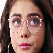

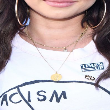

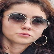

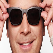

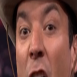

...

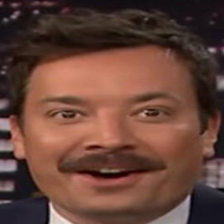

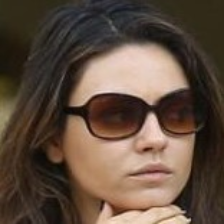

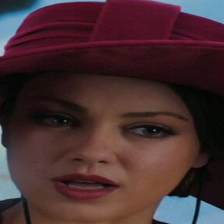

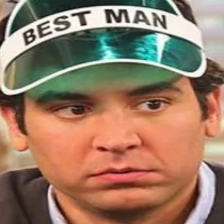

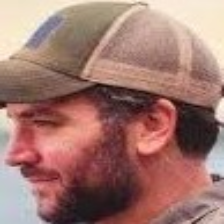

In [ ]:
#use images that are partly obstructed

obstructed_person_a_test = []
obstructed_person_b_test = []
obstructed_person_c_test = []
obstructed_person_d_test = []
obstructed_images = []

for i in range (1, 5):
    obstructed_person_a_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/Sarah_Hyland' + str(i) + '.jpg'))


obstructed_person_b_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/Jimmy_Fallon1.jpg'))
obstructed_person_b_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/Jimmy_Fallon2.jpg'))
obstructed_person_b_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/Jimmy_Fallon3.jpg'))
obstructed_person_c_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/Mila_Kunis1.jpg'))
obstructed_person_c_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/Mila_Kunis2.jpg'))
obstructed_person_d_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/Josh_Radnor1.jpg'))
obstructed_person_d_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/Josh_Radnor2.jpg'))

obstructed_images = obstructed_person_a_test + obstructed_person_b_test + obstructed_person_c_test + obstructed_person_d_test

#for i in obstructed_images:
#    cv2_imshow(i)

obstructed_faces = get_faces(obstructed_images)

for i in obstructed_faces:
    cv2_imshow(i)

# we see that the face detection often doesn't work so we use manually cropped faces

obstructed_faces_manual = []
obstructed_face_a_test = []
obstructed_face_b_test = []
obstructed_face_c_test = []
obstructed_face_d_test = []

for i in range (1, 5):
    obstructed_face_a_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/faces/Sarah_Hyland' + str(i) + '.jpg'))

obstructed_face_b_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/faces/Jimmy_Fallon1.jpg'))
obstructed_face_b_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/faces/Jimmy_Fallon2.jpg'))
obstructed_face_b_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/faces/Jimmy_Fallon3.jpg'))
obstructed_face_c_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/faces/Mila_Kunis1.jpg'))
obstructed_face_c_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/faces/Mila_Kunis2.jpg'))
obstructed_face_d_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/faces/Josh_Radnor1.jpg'))
obstructed_face_d_test.append(download_image('https://raw.githubusercontent.com/NilsVH/CVAS2/master/CVAS2/obstruction/faces/Josh_Radnor2.jpg'))

obstructed_faces_manual = obstructed_face_a_test + obstructed_face_b_test + obstructed_face_c_test + obstructed_face_d_test
obstructed_faces_labels_manual = [0,0,0,0,1,1,1,2,2,3,3]

for i in obstructed_faces_manual:
    cv2_imshow(i)

#plug-in to classifier



In [ ]:
# obstructed_faces, obstructed_labels = get_faces(images=obstructed_images, labels=[0,0,0,0,0,1,1,1,2,2,3,3])


In our first attempt to break the classification for the different feature representations we're going to use obstructed images. In the train fase, we'll be using our normal training images, but the test images will consist of our former test faces with some kind of obstruction like a hat or glasses. We'll take a look at the effects on the different feature representations.

Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

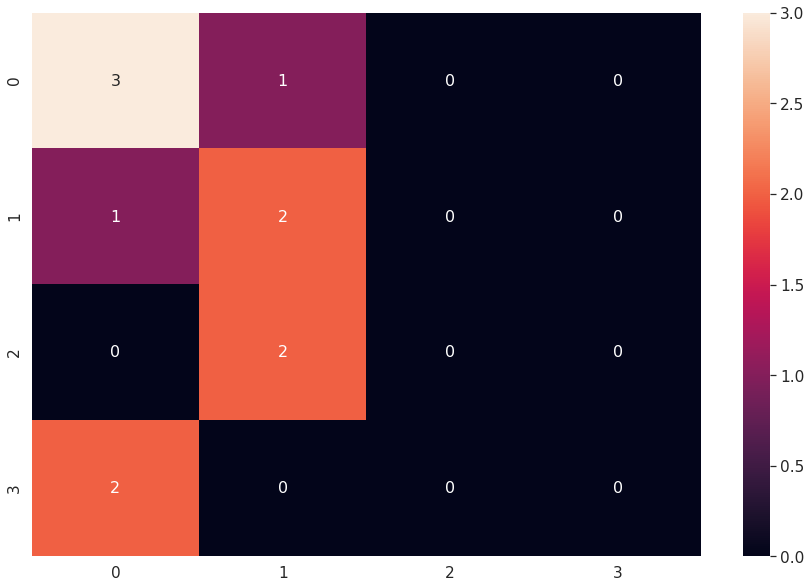

Train Accuracy for pca features with model LogisticRegression is 100.0%.
Test Accuracy for pca features with model LogisticRegression is 36.36363636363637%.


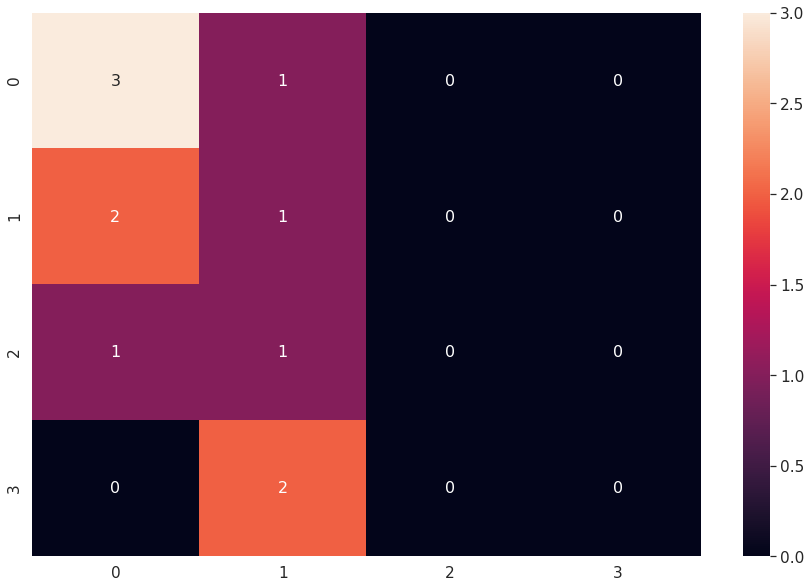

Train Accuracy for vgg features with model LogisticRegression is 100.0%.
Test Accuracy for vgg features with model LogisticRegression is 45.45454545454545%.


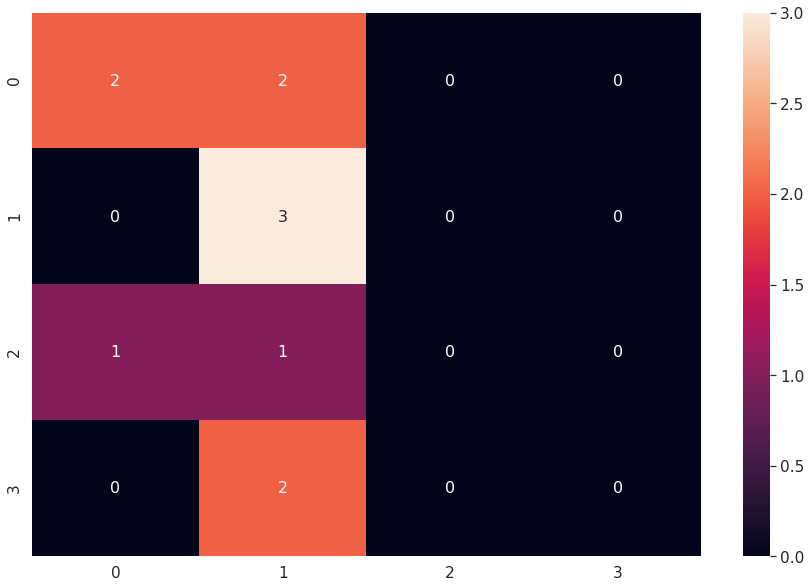

Train Accuracy for sift features with model GaussianNB is 70.0%.
Test Accuracy for sift features with model GaussianNB is 36.36363636363637%.


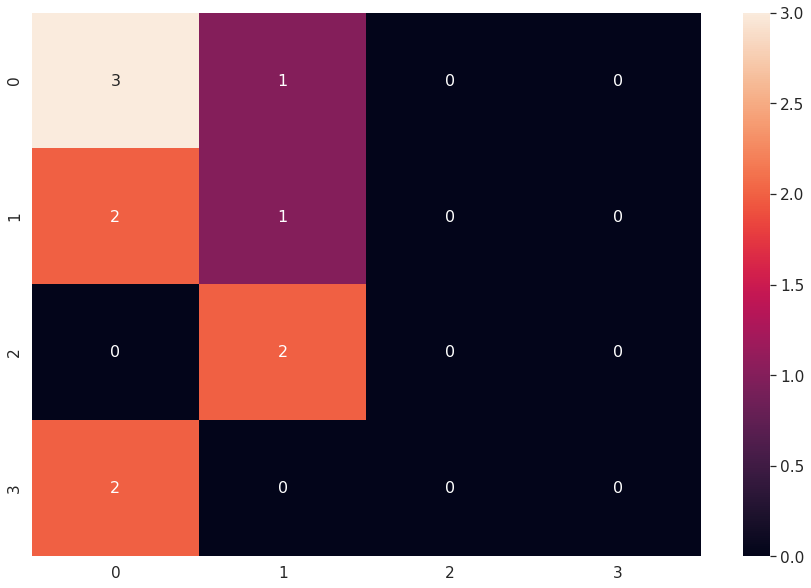

Train Accuracy for pca features with model GaussianNB is 82.5%.
Test Accuracy for pca features with model GaussianNB is 45.45454545454545%.


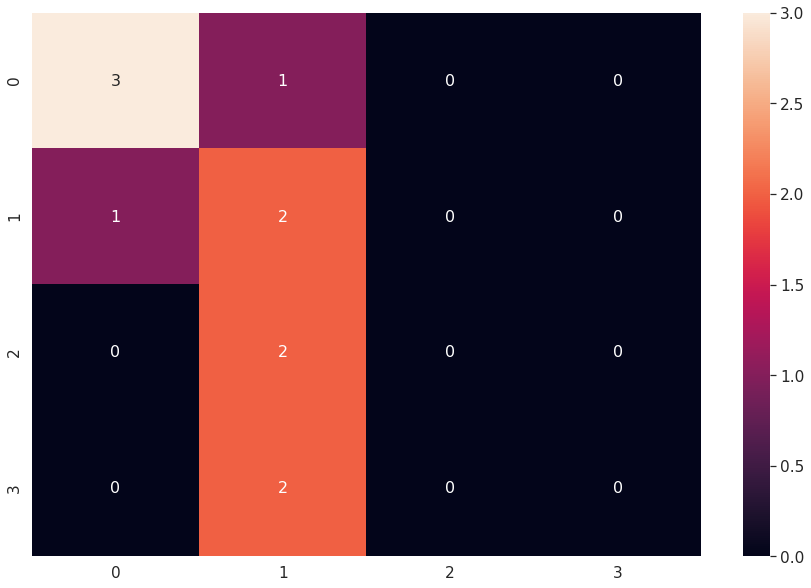

Train Accuracy for vgg features with model GaussianNB is 100.0%.
Test Accuracy for vgg features with model GaussianNB is 54.54545454545454%.


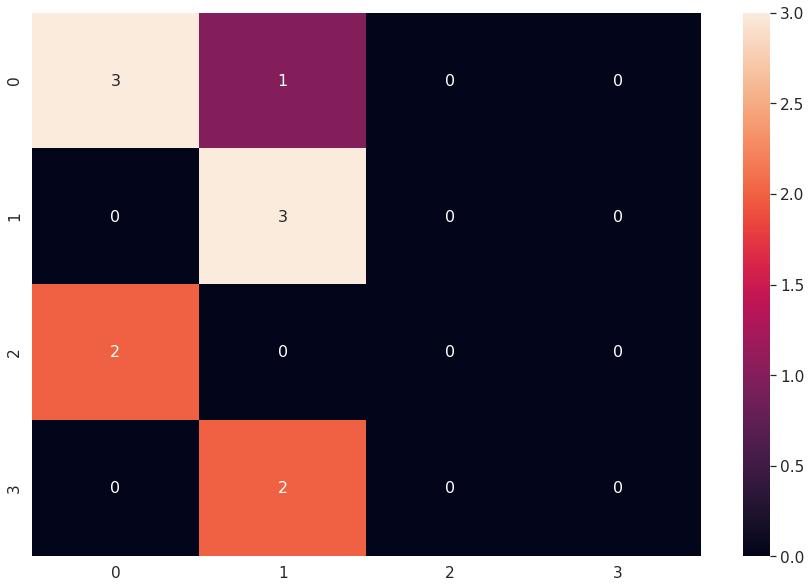

Train Accuracy for sift features with model RandomForestClassifier is 100.0%.
Test Accuracy for sift features with model RandomForestClassifier is 36.36363636363637%.


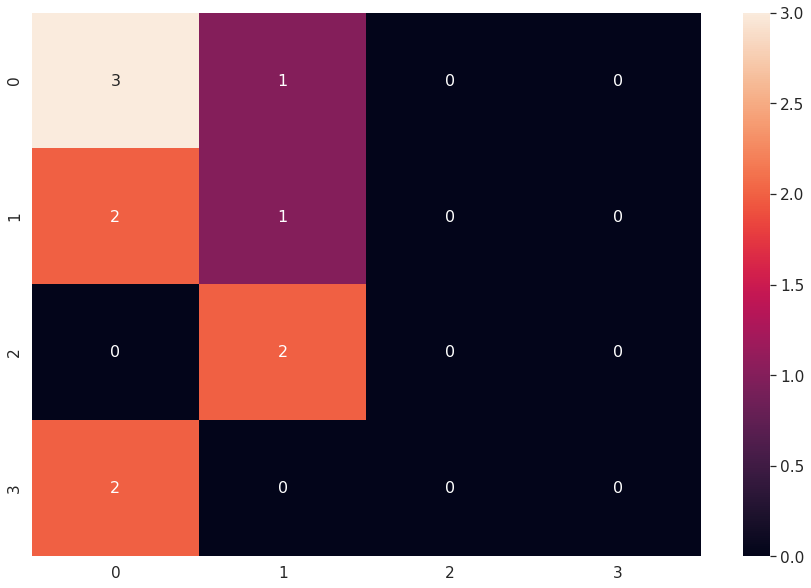

Train Accuracy for pca features with model RandomForestClassifier is 100.0%.
Test Accuracy for pca features with model RandomForestClassifier is 36.36363636363637%.


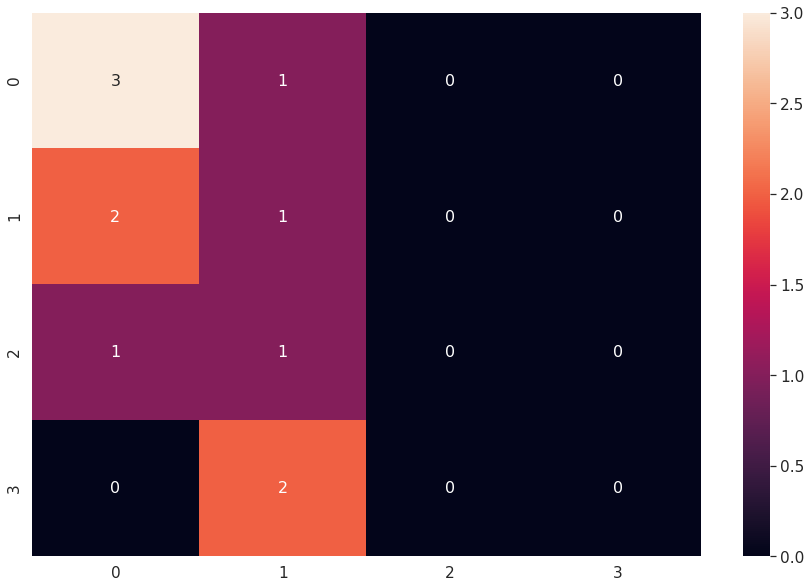

Train Accuracy for vgg features with model RandomForestClassifier is 100.0%.
Test Accuracy for vgg features with model RandomForestClassifier is 54.54545454545454%.


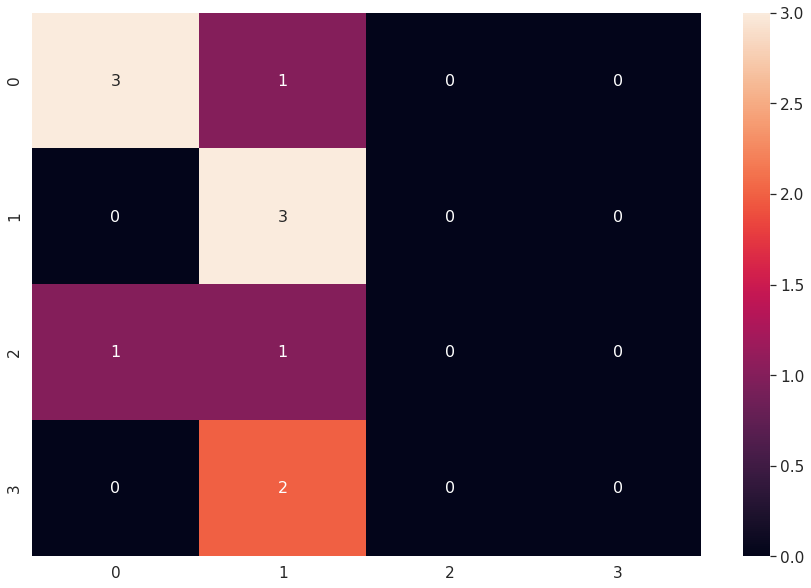

In [ ]:
train_faces = get_faces(train_set)
test_faces = obstructed_faces_manual
models = [LogisticRegression(), GaussianNB(), RandomForestClassifier()]
feature_representations = ['sift', 'pca', 'vgg']

if len(train_faces) or len(test_faces) < 30:
  n_components = len(test_faces)

for model in models:
  for feature_representation in feature_representations:
    train_features = create_features(images=train_faces, 
                                  feature_representation=feature_representation,
                                  n_components=n_components)
    test_features = create_features(images=test_faces, 
                                  feature_representation=feature_representation,
                                  n_components=n_components)
    train_features = np.asarray(train_features)
    test_features = np.asarray(test_features)

    model.fit(np.asarray(train_features), np.asarray(train_targets))
    train_predictions = model.predict(train_features)
    test_predictions = model.predict(test_features)
    print("Train Accuracy for {} features with model {} is {}%.".format(feature_representation, 
                                                                        type(model).__name__,
                                                                        accuracy_score(train_targets, train_predictions)*100))
    print("Test Accuracy for {} features with model {} is {}%.".format(feature_representation,
                                                                    type(model).__name__,
                                                                    accuracy_score(obstructed_faces_labels_manual, test_predictions)*100))
    
    conf = confusion_matrix(obstructed_faces_labels_manual, test_predictions)
    df_cm = pd.DataFrame(conf, range(len(set(obstructed_faces_labels_manual))), range(len(set(obstructed_faces_labels_manual))))
    # plt.figure(figsize=(10,7))
    sn.set(font_scale=1.4) # for label size
    sn.heatmap(df_cm, annot=True, annot_kws={"size": 16}) # font size

    plt.show()

Next, we'll do the same thing for rotated images

In [ ]:
len(test_faces)

11

Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 face(s)! Only using one
Found 2 face(s)! Only using one
Found 1 face(s)! Only using one
Found 1 

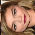

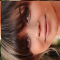

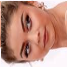

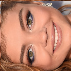

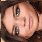

...

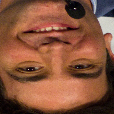

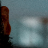

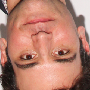

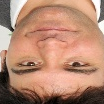

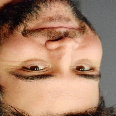

In [ ]:

# count test set
train_faces = get_faces(train_set)
test_faces = get_faces(test_set)
num_in_test_faces = len(test_faces)
print (num_in_test_faces)

#rotated test faces
rotated_test_set = []

# rotate left
for face in test_faces[:12]:
    h,w,c = face.shape
    rotated_img = np.zeros([h,w,c], dtype=np.uint8)
    for i in range(h):
        for j in range(w):
            rotated_img[i,j] = face[j-1,i-1]
            rotated_img = rotated_img[0:h,0:w]
    rotated_test_set.append(rotated_img)
    cv2_imshow(rotated_img)

# rotate right
for i in range (12, 24):
    face = test_faces[i]
    h,w,c = face.shape
    rotated_img = np.zeros([h,w,c], dtype=np.uint8)
    for i in range(h):
        for j in range(w):
            rotated_img[i,j] = face[h-j-1,w-i-1]
            rotated_img = rotated_img[0:h,0:w]
    rotated_test_set.append(rotated_img)
    cv2_imshow(rotated_img)

#rotate upside down
for i in range (24, 40):
    face = test_faces[i]
    h,w,c = face.shape
    rotated_img = np.zeros([h,w,c], dtype=np.uint8)
    for i in range(h):
        for j in range(w):
            rotated_img[i,j] = face[h-i-1,w-j-1]
            rotated_img = rotated_img[0:h,0:w]
    rotated_test_set.append(rotated_img)
    cv2_imshow(rotated_img)

In [ ]:
len(rotated_test_set)

40

Train Accuracy for sift features with model LogisticRegression is 77.5%.
Test Accuracy for sift features with model LogisticRegression is 35.0%.


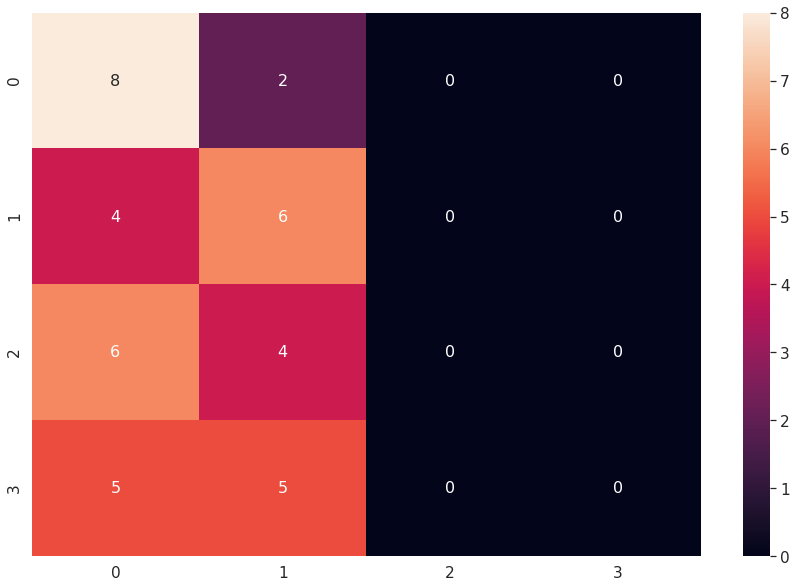

Train Accuracy for pca features with model LogisticRegression is 100.0%.
Test Accuracy for pca features with model LogisticRegression is 32.5%.


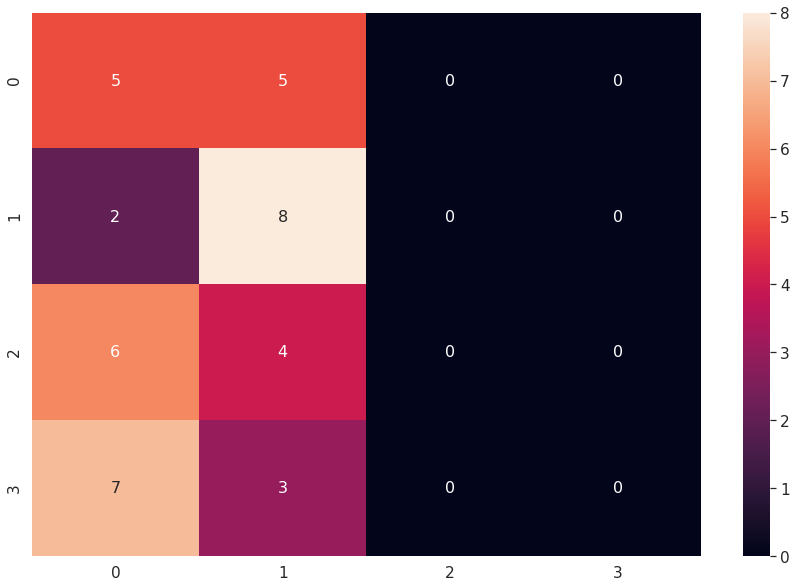

Train Accuracy for vgg features with model LogisticRegression is 100.0%.
Test Accuracy for vgg features with model LogisticRegression is 25.0%.


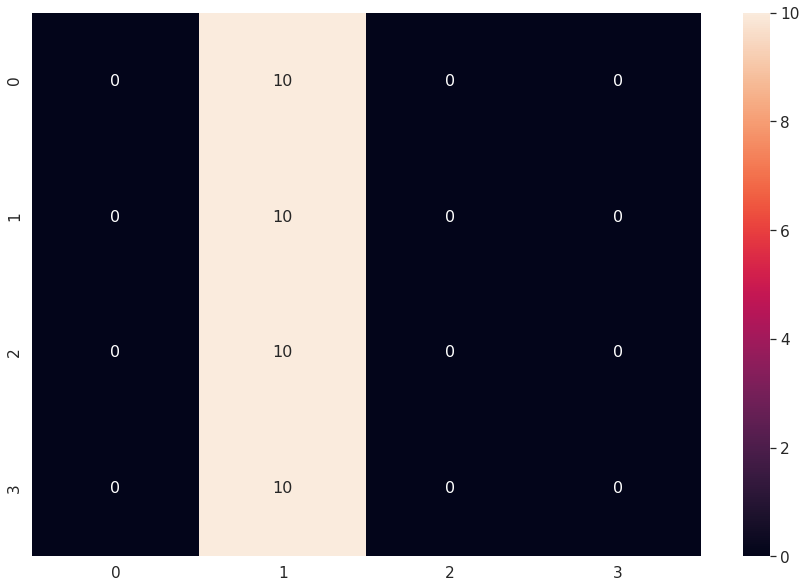

Train Accuracy for sift features with model GaussianNB is 70.0%.
Test Accuracy for sift features with model GaussianNB is 37.5%.


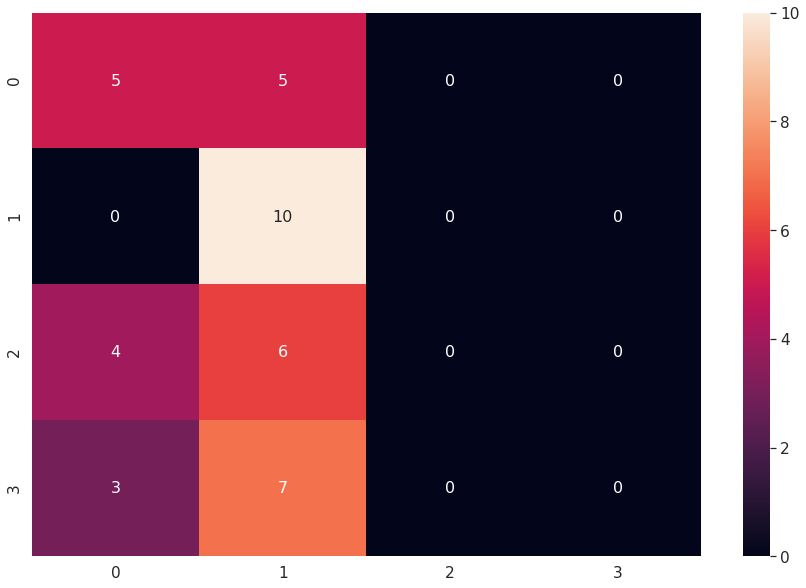

Train Accuracy for pca features with model GaussianNB is 95.0%.
Test Accuracy for pca features with model GaussianNB is 30.0%.


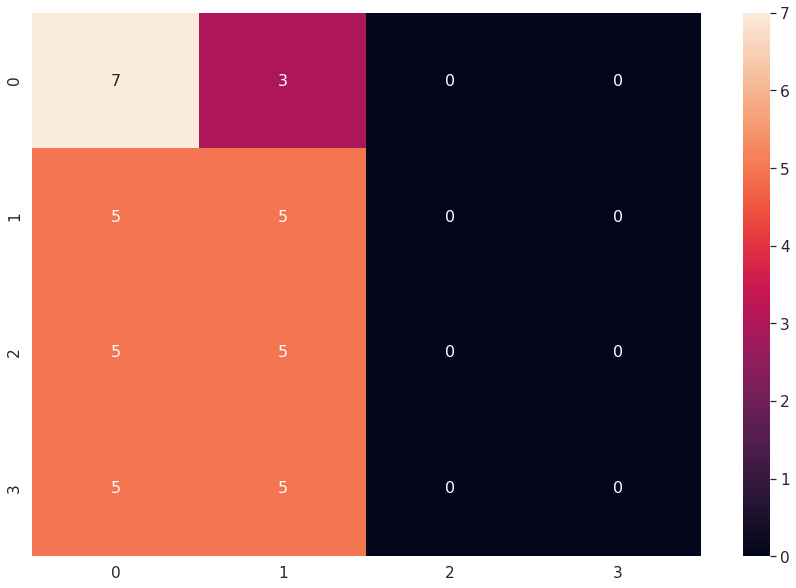

Train Accuracy for vgg features with model GaussianNB is 100.0%.
Test Accuracy for vgg features with model GaussianNB is 25.0%.


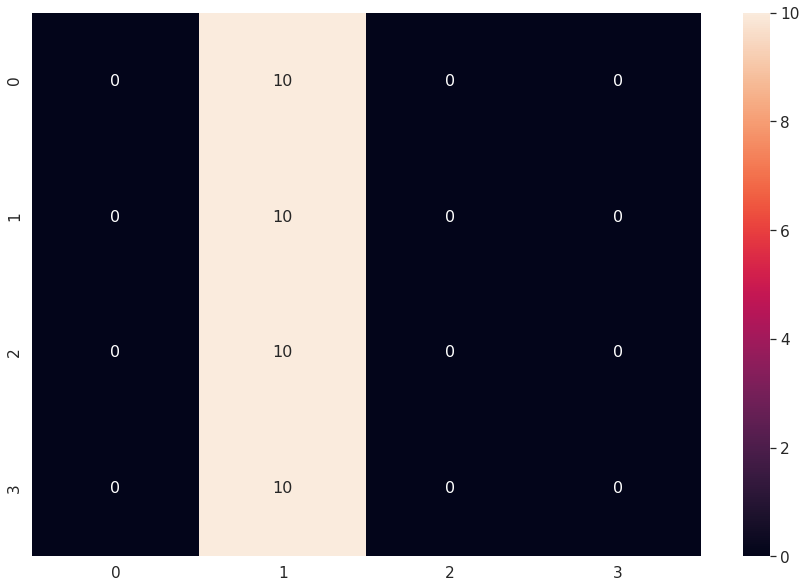

Train Accuracy for sift features with model RandomForestClassifier is 100.0%.
Test Accuracy for sift features with model RandomForestClassifier is 30.0%.


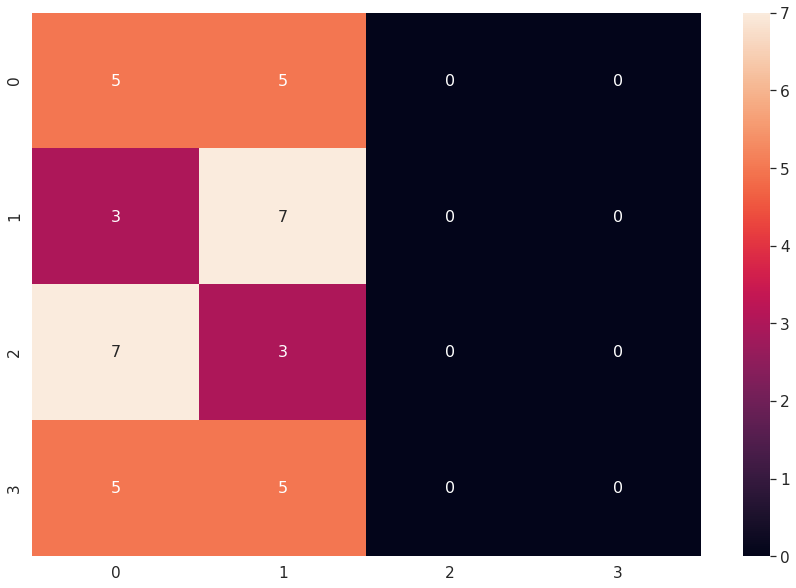

Train Accuracy for pca features with model RandomForestClassifier is 100.0%.
Test Accuracy for pca features with model RandomForestClassifier is 30.0%.


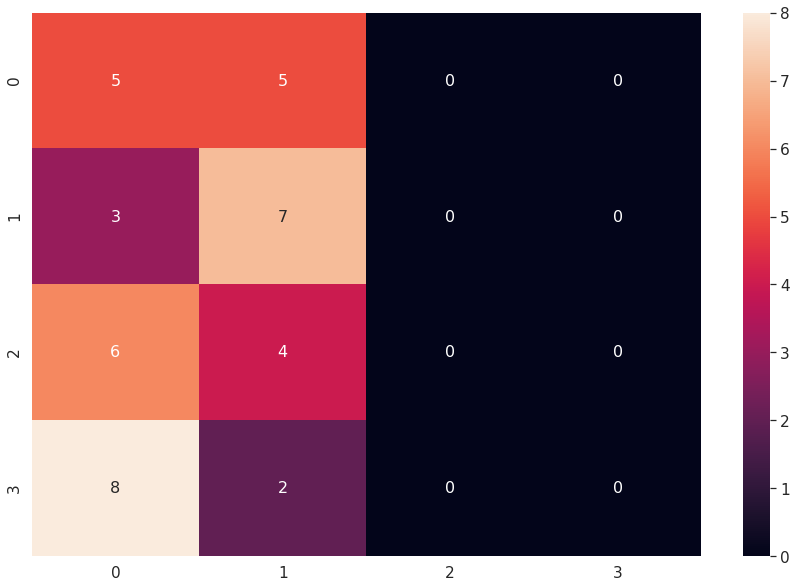

Train Accuracy for vgg features with model RandomForestClassifier is 100.0%.
Test Accuracy for vgg features with model RandomForestClassifier is 25.0%.


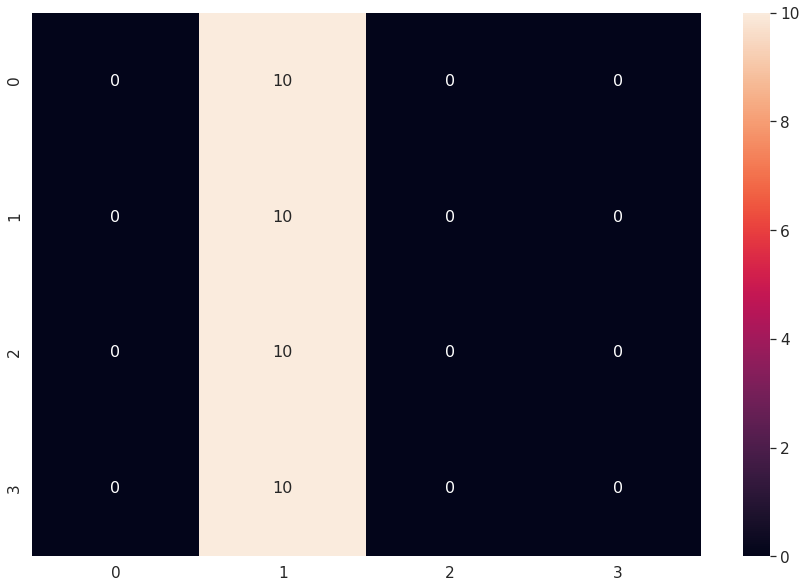

In [ ]:
models = [LogisticRegression(), GaussianNB(), RandomForestClassifier()]
feature_representations = ['sift', 'pca', 'vgg']

if len(train_faces) or len(rotated_test_set) < 30:
  n_components = len(rotated_test_set)

for model in models:
  for feature_representation in feature_representations:
    train_features = create_features(images=train_faces, 
                                  feature_representation=feature_representation,
                                  n_components=n_components)
    test_features = create_features(images=rotated_test_set, 
                                  feature_representation=feature_representation,
                                  n_components=n_components)
    train_features = np.asarray(train_features)
    test_features = np.asarray(test_features)

    model.fit(np.asarray(train_features), np.asarray(train_targets))
    train_predictions = model.predict(train_features)
    test_predictions = model.predict(test_features)
    print("Train Accuracy for {} features with model {} is {}%.".format(feature_representation, 
                                                                        type(model).__name__,
                                                                        accuracy_score(train_targets, train_predictions)*100))
    print("Test Accuracy for {} features with model {} is {}%.".format(feature_representation,
                                                                    type(model).__name__,
                                                                    accuracy_score(test_targets, test_predictions)*100))
    
    conf = confusion_matrix(test_targets, test_predictions)
    df_cm = pd.DataFrame(conf, range(len(set(test_targets))), range(len(set(test_targets))))
    # plt.figure(figsize=(10,7))
    sn.set(font_scale=1.4) # for label size
    sn.heatmap(df_cm, annot=True, annot_kws={"size": 16}) # font size

    plt.show()

**Conclusion for breaking the classifier**

Breaking the classifier can be done quite easily if we keep in mind the properties of each classifier. Both PCA and SIFT still perform reasonably well for obstructions and rotations.  For rotations this makes sense for both SIFT and PCA since the rotations don’t impact recognition of keypoints of sift and totally don’t impact principal components. The obstructions do have some more effect on sift since it can obscure certain keypoints.  

The classification using the VGG feature representation, which in our normal tests performs best, can be totally broken by rotating. The reason for this is that the pretrained VGG makes use of a totally different feature representation based on seen images. Likely these feature representations also include the angle of the object. Since we completely changes this feature by rotating which is not present in the training data, the classifier performs very poorly. A plot of the feature space could reveal this.



## **6.**


### **Discussion**


**Summarize what you have learned in this assignment**

1. Working with a template notebook on Google Colab.
2. Using transfer learning with the TensorFlow/Keras library. 
3. Using OpenCV to detect the faces and extracting them.
4. Which feature representation methods there are:
      * Handcrafted features  
      * Features learned from data 
5. How to build both types of features on the faces dataset.
6. Building an handcrafted feature descriptor from SIFT, a state-of-the-art handcrafted image feature descriptor.
7. Matching: How to detect an object of interest in a new image involving matching the local descriptors to the image.
8. Principal Components Analysis (PCA) to find the different components of variation present in our faces training set.   
9. Both PCA and SIFT are unsupervised learning and transfer learning is supervised
10. PCA make use of dimensionality reduction
11. The VGG dataset is trained on a diverse dataset containing faces.

**Discuss qualitative differences between the different feature representations that you constructed on your (small) faces training set.Discuss the results on the test images for the two tasks?**

We used 3 different feature representations for classifying/identifying the different faces of the persons in the test set. All these feature representations were trained on classification models that are derived from a so-called different Machine Learning Family to get a better view on how good the feature representations can be used to classify. Improvements could be made to these models since no parameter fine-tuning was done in this set-up.

It is important to note that the 'similar looking' faces of different persons in the test set got their own label. It was not clear whether this was the correct way to do this or that they should have gotten the label of the person they look similar too. In any case, it is impossible for a supervised learning model to classifiy/identify an unseen label. However, we can still draw conclusions for their predicted class. The prediction on the train set was done to set a benchmarking example and to be sure that the training of the models was done correctly. They should all be at 100% accuracy because the model has already seen these examples.

In short, the VGG Features do a far better job in all models than the other two feature representations. It labels the first two (seen) persons from the test set perfectly. Moreover, it also near perfect labels the similar looking persons to the ones they look like. This shouldn't surprise us. On the one hand, the VGG features are drawn from a very recent, very deep convolutional model that has a well-thought architecture and a proven record of ranking high in image classification competitions. On the other hand, these are the only features that were created by training on a vast amount of images since we're using a pre-trained model. Still, the training set we're using for our classification, is still way to small to obtain the best results.

The other two feature representations were not created by cutting of a pre-trained model. Instead SIFT and PCA 'harvest' the key elements of the images to try and create meaningful representations of the images that can be used in a classification algorithm. The SIFT algorithm performs slightly better than a random assignment of labels would. At performs worse on labeling the 'similar' faces. This is not very good and could be a result of the lack of training data. Apart from that, the number of keypoints and the number of clusters could also be fine-tuned to improve this feature representation.

Finally, the PCA feature representation performs worse than a random baseline classifier would. A fine-tuning of the number of components to take, could improve this model.

To conclude, it seems that the VGG feature representation is the most robust representation to classify the image correctly. We can verify this because it is the best performing feature, regardless of the model used. The carefully designed model architecture and the huge dataset that was used for training it, can explain the strength of the VGG feature representation.

**Why would one work better than the other?**

SIFT has greater precision for Binary Images with Scale Invariance, i.e. Same images of different sizes are retrieved with more accuracy in SIFT than PCA. SIFT has better Image retrieval for RotatedImages. SIFT has better performance on Transposed Images. SIFT and PCA both work good on Color Images. Hence PCA is used in face recognition software. 

Transfer Learning has the advantage that the model is pretrained on lots of images. The model is also tested broadly. This ensures that it gives a better result.
  
**What would you do better/more if you would have plenty of time to spend on this step?**

We would spend more time on pre-processing. Also we would try to get more trainings/test data. 


**Imagine that there is a company that wants to purchase your face detection pro-totype system to install in their offices as a means of authenticating employees. Would it be easy to fool this system?**

The system is not tested with people who are wearing glasses, so it may be possible to fool the system if you wear glasses. In some figures there are also matching points between men and women’s, e.g.,if you change the figure of a man so that the matching point increases, then it’s a possibility that a person can be wrongly classified.

**What would you advise the company?**

To use a lot more training data, also using a lot of variations in the picture( hat, glasses, beard,...). Also more test data so you can have a better conclusion.

**What are the current limitations of your prototype and what would you do next to make your system better?**

SIFT limitations:

*   When the intensity of the image is constant, then no keypoints can be detected in the image 
*   When the intensity of the image pare is not exactly constant but if their variances are low, then only some keypoints are detected in the image but with a low stability.

Possible solution: A solution for the situation when the pattern and its original image lack a sufficient amount of keypoints, is that we can apply a different method based on context matching, e.g., to obtain an approximate match of the pattern with a database image and mark its approximate position in the image. Then, only this approximately marked area of the image(s) is considered as an input for the SIFT algorithm. It’s been researched that the combination between the two methods:

*   Keypoints matching of the pattern
*   The “pre-processed” image 

Works perfectly and solves the current limitations.

PCA limitations:

* When there are different shadings, the classification may not give the desired result.

Possible solution: applying gamma correction on the image.